In [1]:
import astropy.units as u
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
# from astropy.io import fits
from astropy.table import Table

In [2]:
def AB_2_Jy(AB_mag): 
    F = 10**(23-(AB_mag+48.6)/2.5) # [Jy]
    return F

def Jy_2_AB(Jy):
    mag = -2.5*np.log10(Jy) + 8.9
    return mag

def EmittionLineIntensity(mag, coefficients):
    
    flux = AB_2_Jy(mag)*1e6 # [uJy]
        
    # logx = log(y) = a + b*log(x)
    intensity = 10**(coefficients[0] + coefficients[1]*np.log10(flux))
    
    # unit: 1e-17 erg/s/cm^2
    return intensity
    
def z2D(z, H0=70, unit=u.pc):
    H = H0 * u.km / u.s / u.Mpc
    c = 3e5 * u.km / u.s
    
    def calculate_distance(z_value):
        D = z_value * c / H
        return D.to(unit)
    
    if isinstance(z, pd.Series):
        return z.apply(calculate_distance)
    else:
        return calculate_distance(z)

def SFR2Halpha(SFR, z):
    
    # Kennicutt 1998
    # SFR [M_Sun/yr] = L_Halpha / 1.26e41[erg/s]
    
    L_Halpha = (10**(41.16-0.88 + 0.29*np.log10(SFR))) * u.erg / u.s # [erg/s]
    E_Halpha = L_Halpha / (4*np.pi * z2D(z, unit=u.cm)**2) # [erg/s/cm^2]
    
    return E_Halpha

def SFR2Halpha_obs(SFR, z):
    
    # From Seong Jin, include the dust extinction
    # SFR [M_Sun/yr] = L_Halpha / 1.26e41[erg/s]
    
    L_Halpha = 1.26e41 * SFR * u.erg / u.s # [erg/s]
    E_Halpha = L_Halpha / (4*np.pi * z2D(z, unit=u.cm)**2) # [erg/s/cm^2]
    
    return E_Halpha

def M_Abs2m_ab(M_abs, z):
    # M_abs = m_ab - 5 * log10(D) + 5
    m_ab = M_abs + 5 * np.log10(z2D(z, unit=u.pc).apply(lambda x: x.value)/10) - 5
    return m_ab


In [15]:
Jy_2_AB(0.1/1000)

18.9

### exp cut

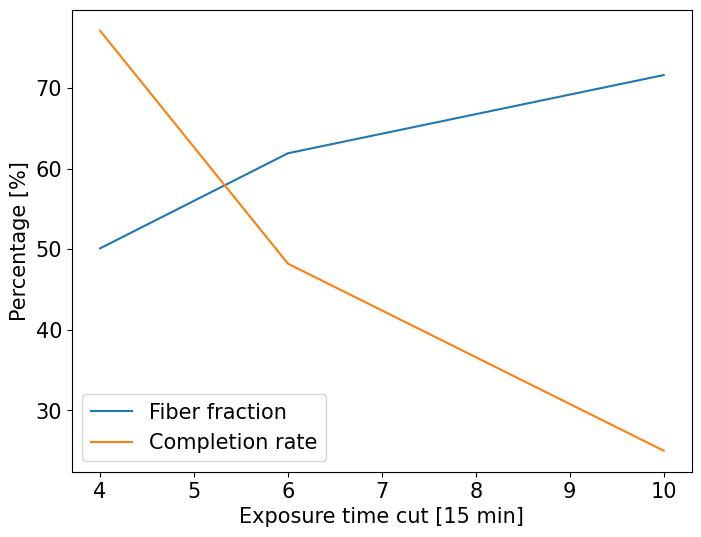

In [2]:
fig, ax = plt.subplots(1, 1, figsize=(8, 6))

exp_cut = [10, 6, 4]
Fiber_fraction = [71.6, 61.9, 50.1]
complete_targets = [25, 48.2, 77.1]
p0sources = 7000

ax.plot(exp_cut, Fiber_fraction, label='Fiber fraction')
ax.plot(exp_cut, complete_targets, label='Completion rate')

ax.legend(fontsize=15)
ax.set_xlabel('Exposure time cut [15 min]', fontsize=15)
ax.set_ylabel('Percentage [%]', fontsize=15)
ax.tick_params(axis='both', which='major', labelsize=15)

plt.show()

### Data

In [ ]:
#   1 Number          id number (sorted in order of RA)
#   2 ALPHA_J2000     Right ascension of barycenter (J2000)           [deg]
#   3 DELTA_J2000     Declination of barycenter (J2000)               [deg]
#   4 Mag             Auto_Mag with a Kron-like elliptical aperture   [AB]
#   5 Mag_Err         RMS err for auto_mag                            [mag]
#   6 X_IMAGE         Object position along x                         [pixel]
#   7 Y_IMAGE         Object position along y                         [pixel]
#   8 NUMBER          Running object number from SExtractor
#   9 FLAGS           Extraction flags

In [3]:
header = ['Number', 'ALPHA_J2000', 'DELTA_J2000', 'Mag', 'Mag_Err', 'X_IMAGE', 'Y_IMAGE', 'NUMBER', 'FLAGS']
NEPW_L18W = pd.read_fwf('./AKARI_NEP/NEPW_L18W_AutoMag.cat.txt', delimiter=' ', header=None, names=header)
NEPW_S9W = pd.read_fwf('./AKARI_NEP/NEPW_S9W_AutoMag.cat.txt', delimiter=' ', header=None, names=header)

In [3]:
data = pd.read_fwf('./AKARI_NEP/fin_AKR_HSC_cln10z+.cat.txt', delimiter=' ')
data.drop(0,inplace=True)
S9mag = data['S9m'].astype(float).loc[data['S9m'].astype(float) < 30]
S9mag_nospec = S9mag[data['id_spz']=='________________']
L18mag = data['L18m'].astype(float).loc[data['L18m'].astype(float) < 30]
L18mag_nospec = L18mag[data['id_spz']=='________________']
Both = data[(data['S9m'].astype(float) < 30) & (data['L18m'].astype(float) < 30)]
Both = Both[Both['id_spz']=='________________']

### output catalog

In [5]:
target = data[((data['S9m'].astype(float) < 30) | (data['L18m'].astype(float) < 30)) & (data['id_spz']=='________________')]

In [6]:
len(target)

12893

In [7]:
sigma = 2

L18W2Halpha = [0.68-0.37*sigma, 0.58]
L18W2Hbeta = [0.02-0.51*sigma, 0.59]
S9W2Halpha = [0.64-0.34*sigma, 0.6]
S9W2Hbeta = [0.09-0.36*sigma, 0.57]

S9E_I_alpha = EmittionLineIntensity(target['S9m'].astype(float), S9W2Halpha)
S9E_I_beta = EmittionLineIntensity(target['S9m'].astype(float), S9W2Hbeta)
L18E_I_alpha = EmittionLineIntensity(target['L18m'].astype(float), L18W2Halpha)
L18E_I_beta = EmittionLineIntensity(target['L18m'].astype(float), L18W2Hbeta)

target[f'H_a_{sigma}sig_S9m'] = S9E_I_alpha
target[f'H_b_{sigma}sig_S9m'] = S9E_I_beta
target[f'H_a_{sigma}sig_L18m'] = L18E_I_alpha
target[f'H_b_{sigma}sig_L18m'] = L18E_I_beta

/tmp/ipykernel_74586/2889064675.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  target[f'H_a_{sigma}sig_S9m'] = S9E_I_alpha
/tmp/ipykernel_74586/2889064675.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  target[f'H_b_{sigma}sig_S9m'] = S9E_I_beta
/tmp/ipykernel_74586/2889064675.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pan

In [8]:
target

,# Trt-Ptch,HSC-ID,forced_RA,forced-Dec,GCm,GCme,RCm,RCme,ICm,ICme,...,l68,h68 fl1 fl2 chi_gal,chi_star,chi_QSO,Mbest,SFRbst,H_a_2sig_S9m,H_b_2sig_S9m,H_a_2sig_L18m,H_b_2sig_L18m
1,18012_0_7,79217643822780069,270.7276917,65.3166046,23.481,0.014,21.951,0.005,21.276,0.010,...,0.449,0.638 1 1 2.148e+01,8.056e+01,1.350e+01,10.294,-5.286,2.019296e+01,4.445698e+00,3.287002e-18,1.889731e-19
8,18012_0_7,79217643822780448,270.7470093,65.3519974,21.705,0.004,20.215,0.001,19.425,0.002,...,0.359,0.408 1 1 7.511e+00,1.239e+02,7.517e+00,10.784,-0.891,1.514119e+01,3.381832e+00,1.849439e+01,2.238309e+00
13,18012_0_7,79217643822780857,270.7791748,65.3472900,25.037,0.061,23.960,0.032,23.674,0.093,...,2.523,3.240 1 1 4.914e-01,3.456e+01,2.871e+00,11.054,0.465,8.629785e-19,1.766851e-18,1.563004e+01,1.886166e+00
17,18012_0_7,79217643822781099,270.7459412,65.3422089,21.695,0.004,20.555,0.002,20.245,0.006,...,0.345,0.452 1 1 6.972e+00,2.571e+02,1.785e+01,9.983,-0.126,1.391362e+01,3.120815e+00,1.647889e+01,1.990417e+00
19,18012_0_7,79217643822781289,270.7485352,65.3013153,22.028,0.008,20.708,0.002,99.000,99.000,...,0.362,0.442 1 1 6.299e+00,5.250e+01,1.126e+01,10.613,-0.292,2.234189e+01,4.894000e+00,3.287002e-18,1.889731e-19
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91856,18212_4_2,80097781406014450,272.6167603,67.3889389,27.006,0.137,99.000,99.000,99.000,99.000,...,1.000,1.000 2 1 1.000e+10,1.000e+10,1.000e+10,6.371,-0.970,8.629785e-19,1.766851e-18,3.563986e+01,4.362425e+00
91857,18212_4_2,80097781406014469,272.6238403,67.3892746,26.014,0.038,26.075,0.141,25.452,0.153,...,0.859,2.543 1 1 9.390e-02,1.573e+00,4.601e-02,10.085,-0.174,8.629785e-19,1.766851e-18,4.141217e+01,5.082109e+00
91858,18212_4_2,80097781406014756,272.6203918,67.4040375,26.740,0.068,99.000,99.000,99.000,99.000,...,1.000,1.000 2 1 1.000e+10,1.000e+10,1.000e+10,99.000,-99.000,8.629785e-19,1.766851e-18,5.993383e+01,7.402118e+00
91860,18212_4_2,80097781406015016,272.6665955,67.3938675,27.464,0.143,25.471,0.090,99.000,99.000,...,1.572,4.204 1 1 2.215e-05,1.502e+00,3.250e-05,9.571,1.086,8.629785e-19,1.766851e-18,3.018450e+01,3.684105e+00


In [19]:
target['priority'] = target['photz'].apply(lambda x: 1 if float(x) > 0.9 else 0)

/tmp/ipykernel_74586/1352453065.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  target['priority'] = target['photz'].apply(lambda x: 1 if float(x) > 0.9 else 0)


In [21]:
target[['photz','priority']]

,photz,priority
1,0.562,0
8,0.385,0
13,3.022,1
17,0.411,0
19,0.404,0
...,...,...
91856,1.000,1
91857,1.711,1
91858,1.000,1
91860,3.746,1


In [22]:
target.to_csv('NEP_mergedcat.csv', index=False, sep=',')

In [3]:
data = pd.read_fwf('./AKARI_NEP/fin_AKR_HSC_cln10z+.cat.txt', delimiter=' ')
data.to_csv('NEP_mergedcat.csv')

In [56]:
print(len(L18mag),len(L18mag_nospec),len(S9mag),len(S9mag_nospec),len(Both))

10258 9080 9117 7690 3877


### Emittion intensity

In [3]:
def fraction(data):
    
    f = len(data[(data>1)&(data<3)])/len(data)
    
    return int(f*100)

#### SJ cat

In [43]:
data = pd.read_fwf('./AKARI_NEP/fin_AKR_HSC_cln10z+.cat.txt', delimiter=' ')
data.drop(0,inplace=True)

S9mag = data['S9m'].astype(float).loc[data['S9m'].astype(float) < 30]
S9mag_nospec = S9mag[data['id_spz']=='________________']
L18mag = data['L18m'].astype(float).loc[data['L18m'].astype(float) < 30]
L18mag_nospec = L18mag[data['id_spz']=='________________']

sigma = 2

L18W2Halpha = [0.68-0.37*sigma, 0.58]
L18W2Hbeta = [0.02-0.51*sigma, 0.59]
S9W2Halpha = [0.64-0.34*sigma, 0.6]
S9W2Hbeta = [0.09-0.36*sigma, 0.57]

S9E_I_alpha = EmittionLineIntensity(S9mag_nospec, S9W2Halpha)
S9E_I_beta = EmittionLineIntensity(S9mag_nospec, S9W2Hbeta)
L18E_I_alpha = EmittionLineIntensity(L18mag_nospec, L18W2Halpha)
L18E_I_beta = EmittionLineIntensity(L18mag_nospec, L18W2Hbeta)

data[f'H_a_{sigma}sig_S9m'] = S9E_I_alpha
data[f'H_b_{sigma}sig_S9m'] = S9E_I_beta
data[f'H_a_{sigma}sig_L18m'] = L18E_I_alpha
data[f'H_b_{sigma}sig_L18m'] = L18E_I_beta

In [30]:
len(
    data.loc[
        (data['photz'].astype(float) > 0.9)
        & (data['id_spz']=='________________')
        & (data['RCm'].astype(float) > 14)
        & ((data[f'H_a_{sigma}sig_L18m']>0)|(data[f'H_a_{sigma}sig_S9m']>0)
        |(data[f'H_b_{sigma}sig_L18m']>0)|(data[f'H_b_{sigma}sig_S9m']>0))
        & ((data['chi_gal'].astype(float)<data['chi_star'].astype(float))|
        (data['chi_QSO'].astype(float)<data['chi_star'].astype(float)))
    ]
)

4762

In [32]:
data.loc[
    (data['photz'].astype(float) > 0.9)
    & (data['id_spz']=='________________')
    & (data['RCm'].astype(float) > 14)
    & ((data[f'H_a_{sigma}sig_L18m']>0)|(data[f'H_a_{sigma}sig_S9m']>0)
    |(data[f'H_b_{sigma}sig_L18m']>0)|(data[f'H_b_{sigma}sig_S9m']>0))
    & ((data['chi_gal'].astype(float)<data['chi_star'].astype(float))|
    (data['chi_QSO'].astype(float)<data['chi_star'].astype(float)))
].to_csv('SJ_highz.csv', index=False, sep=',')

##### plot

In [5]:
sigma = 2

L18W2Halpha = [0.68-0.37*sigma, 0.58]
L18W2Hbeta = [0.02-0.51*sigma, 0.59]
S9W2Halpha = [0.64-0.34*sigma, 0.6]
S9W2Hbeta = [0.09-0.36*sigma, 0.57]

S9E_I_alpha = EmittionLineIntensity(S9mag, S9W2Halpha)
S9E_I_alpha_nospec = EmittionLineIntensity(S9mag_nospec, S9W2Halpha)
S9E_I_beta = EmittionLineIntensity(S9mag, S9W2Hbeta)
S9E_I_beta_nospec = EmittionLineIntensity(S9mag_nospec, S9W2Hbeta)
L18E_I_alpha = EmittionLineIntensity(L18mag, L18W2Halpha)
L18E_I_alpha_nospec = EmittionLineIntensity(L18mag_nospec, L18W2Halpha)
L18E_I_beta = EmittionLineIntensity(L18mag, L18W2Hbeta)
L18E_I_beta_nospec = EmittionLineIntensity(L18mag_nospec, L18W2Hbeta)

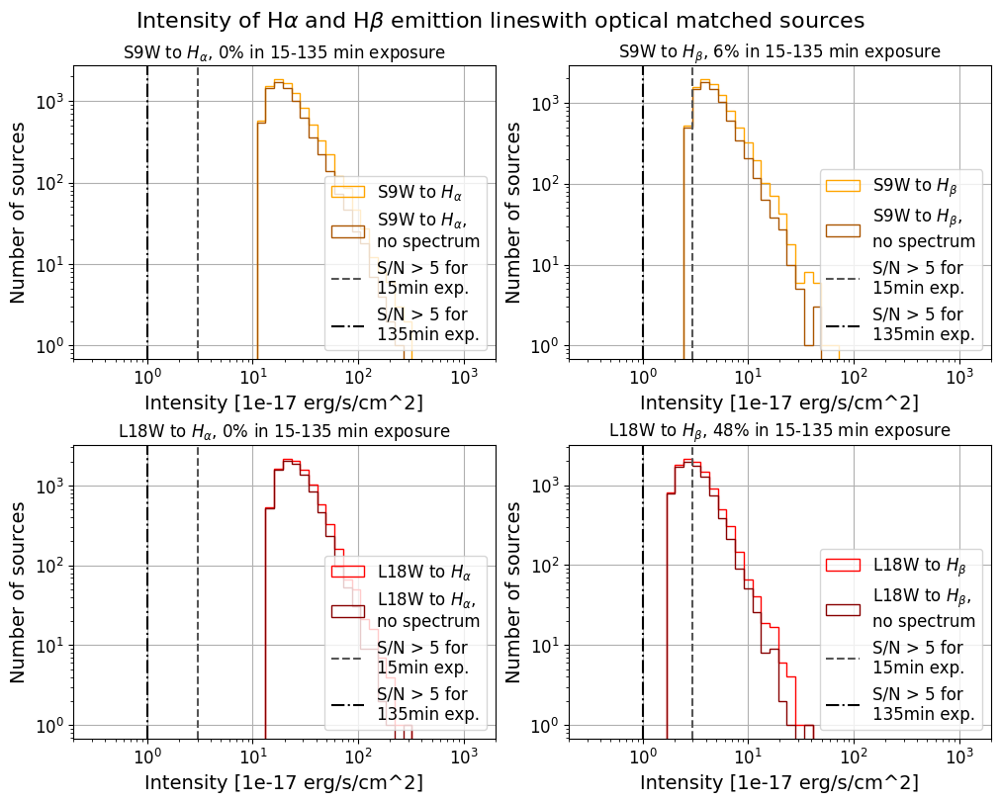

In [8]:
fig, axs = plt.subplots(2,2, figsize=(10,8), constrained_layout=True)

bins = np.logspace(-1, 3, 50)

ax = axs[0, 0]
ax.hist(S9E_I_alpha, bins=bins, histtype='step', color='orange', label='S9W to $H_{\\alpha}$')
ax.hist(S9E_I_alpha_nospec, bins=bins, histtype='step', color='#AA5500', 
        label='S9W to $H_{\\alpha}$, \nno spectrum')
ax.set_title('S9W to $H_{\\alpha}$, '+str(fraction(S9E_I_alpha))+'% in 15-135 min exposure')

ax = axs[0, 1]
ax.hist(S9E_I_beta, bins=bins, histtype='step', color='orange', label='S9W to $H_{\\beta}$')
ax.hist(S9E_I_beta_nospec, bins=bins, histtype='step', color='#AA5500', 
        label='S9W to $H_{\\beta}$, \nno spectrum')
ax.set_title('S9W to $H_{\\beta}$, '+str(fraction(S9E_I_beta))+'% in 15-135 min exposure')

ax = axs[1, 0]
ax.hist(L18E_I_alpha, bins=bins, histtype='step', color='r', label='L18W to $H_{\\alpha}$')
ax.hist(L18E_I_alpha_nospec, bins=bins, histtype='step', color='#880000', 
        label='L18W to $H_{\\alpha}$, \nno spectrum')
ax.set_title('L18W to $H_{\\alpha}$, '+str(fraction(L18E_I_alpha))+'% in 15-135 min exposure')

ax = axs[1, 1]
ax.hist(L18E_I_beta, bins=bins, histtype='step', color='r', label='L18W to $H_{\\beta}$')
ax.hist(L18E_I_beta_nospec, bins=bins, histtype='step', color='#880000', 
        label='L18W to $H_{\\beta}$, \nno spectrum')
ax.set_title('L18W to $H_{\\beta}$, '+str(fraction(L18E_I_beta))+'% in 15-135 min exposure')


for _, ax in enumerate(axs.flatten()):
    ax.axvline(3, color='#555555', linestyle='--', label='S/N > 5 for \n15min exp.')
    ax.axvline(1, color='k', linestyle='-.', label='S/N > 5 for \n135min exp.')
    ax.legend(loc='lower right', fontsize=12)
    ax.set_ylabel('Number of sources', fontsize=14)
    ax.grid()
    ax.set_yscale('log')
    ax.set_xscale('log')
    ax.set_xlim(0.2, 2000)
    ax.set_xlabel('Intensity [1e-17 erg/s/cm^2]', fontsize=14)
    ax.tick_params(axis='both', labelsize=12)

# plt.tight_layout()
plt.suptitle('Intensity of H$\\alpha$ and H$\\beta$ emittion lines'+ 
          'with optical matched sources', fontsize=16)

plt.show()


In [7]:
print(L18E_I_beta.min(), L18E_I_beta.max())

1.689164711653716 34.39758876107869


#### LSBGs

In [10]:
LSBGs = Table.read('Subaru_PSF_proposal_LSBs_Junais.fits', format='fits').to_pandas()
S9mag = Jy_2_AB(LSBGs['S9W']/1e3)
L18mag = Jy_2_AB(LSBGs['L18W']/1e3)

In [49]:
LSBGs['redshift'].max()

0.0999

In [11]:
sigma = 2

L18W2Halpha = [0.68-0.37*sigma, 0.58]
L18W2Hbeta = [0.02-0.51*sigma, 0.59]
S9W2Halpha = [0.64-0.34*sigma, 0.6]
S9W2Hbeta = [0.09-0.36*sigma, 0.57]

S9E_I_alpha = EmittionLineIntensity(S9mag, S9W2Halpha)
S9E_I_beta = EmittionLineIntensity(S9mag, S9W2Hbeta)
L18E_I_alpha = EmittionLineIntensity(L18mag, L18W2Halpha)
L18E_I_beta = EmittionLineIntensity(L18mag, L18W2Hbeta)

In [13]:
len(
    LSBGs.loc[
        (LSBGs['redshift'] < 0.9)
        & (LSBGs['subaru.hsc.r'] < AB_2_Jy(14)*1e3)
        & ((L18E_I_beta>0)|(S9E_I_beta>0))
    ]
)

1631

In [19]:
LSBGs['H_b']=0
# for i in range(len(LSBGs)):
#     if L18E_I_beta[i]<S9E_I_beta[i]:
        

LSBGs['H_b_L18'] = L18E_I_beta
LSBGs['H_b_S9'] = S9E_I_beta
for i, row in LSBGs.iterrows():
    numbers = row[['H_b_L18', 'H_b_S9']]
    # select the lowest but non zero value
    lowest_EI = np.nanmin([num for num in numbers if num != 0])
    LSBGs.at[i, 'H_b'] = lowest_EI
LSBGs.to_csv('LSBGs.csv', index=False, sep=',')

/tmp/ipykernel_149564/1789895860.py:12: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.6854541205650304' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  LSBGs.at[i, 'H_b'] = lowest_EI


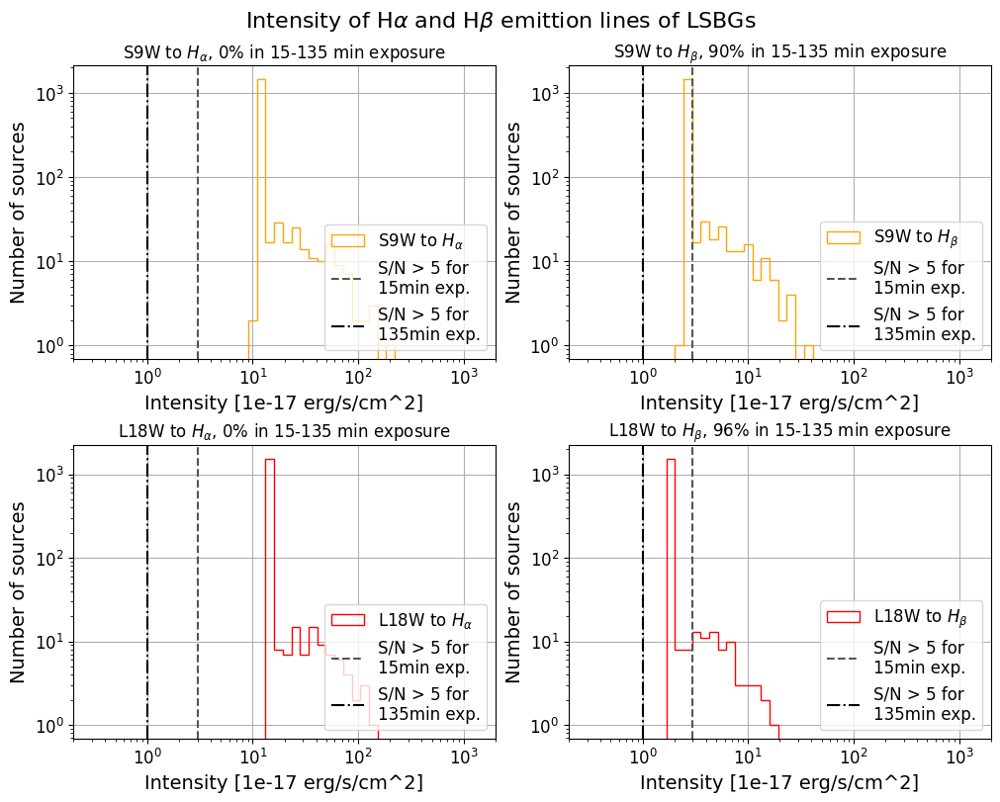

In [6]:
fig, axs = plt.subplots(2,2, figsize=(10,8), constrained_layout=True)

bins = np.logspace(-1, 3, 50)

ax = axs[0, 0]
ax.hist(S9E_I_alpha, bins=bins, histtype='step', color='orange', label='S9W to $H_{\\alpha}$')
ax.set_title('S9W to $H_{\\alpha}$, '+str(fraction(S9E_I_alpha))+'% in 15-135 min exposure')

ax = axs[0, 1]
ax.hist(S9E_I_beta, bins=bins, histtype='step', color='orange', label='S9W to $H_{\\beta}$')
ax.set_title('S9W to $H_{\\beta}$, '+str(fraction(S9E_I_beta))+'% in 15-135 min exposure')

ax = axs[1, 0]
ax.hist(L18E_I_alpha, bins=bins, histtype='step', color='r', label='L18W to $H_{\\alpha}$')
ax.set_title('L18W to $H_{\\alpha}$, '+str(fraction(L18E_I_alpha))+'% in 15-135 min exposure')

ax = axs[1, 1]
ax.hist(L18E_I_beta, bins=bins, histtype='step', color='r', label='L18W to $H_{\\beta}$')
ax.set_title('L18W to $H_{\\beta}$, '+str(fraction(L18E_I_beta))+'% in 15-135 min exposure')


for _, ax in enumerate(axs.flatten()):
    ax.axvline(3, color='#555555', linestyle='--', label='S/N > 5 for \n15min exp.')
    ax.axvline(1, color='k', linestyle='-.', label='S/N > 5 for \n135min exp.')
    ax.legend(loc='lower right', fontsize=12)
    ax.set_ylabel('Number of sources', fontsize=14)
    ax.grid()
    ax.set_yscale('log')
    ax.set_xscale('log')
    ax.set_xlim(0.2, 2000)
    ax.set_xlabel('Intensity [1e-17 erg/s/cm^2]', fontsize=14)
    ax.tick_params(axis='both', labelsize=12)

# plt.tight_layout()
plt.suptitle('Intensity of H$\\alpha$ and H$\\beta$ emittion lines'+ 
          ' of LSBGs', fontsize=16)

plt.show()

#### Will sources

In [4]:
NEP_Will = Table.read('NEP_CIGALE_input.fits', format='fits').to_pandas()
NEP_Will['HSC-ID'] = NEP_Will['id']
S9mag = Jy_2_AB(NEP_Will['akari_irc_s9w']/1e3)
Rmag = Jy_2_AB(NEP_Will['HSC_r']/1e3)

In [5]:
sigma = 2
R2Hbeta = [0.03-0.31*sigma, 0.84]
S9W2Hbeta = [0.09-0.36*sigma, 0.57]

S9W_E_I = EmittionLineIntensity(S9mag, S9W2Hbeta)
R_E_I = EmittionLineIntensity(Rmag, R2Hbeta)

In [6]:
NEP_Will.keys().tolist()

['id',
 'ra',
 'dec',
 'FLAMINGOSJ',
 'FLAMINGOSJ_err',
 'FLAMINGOSH',
 'FLAMINGOSH_err',
 'IRAC1',
 'IRAC1_err',
 'IRAC2',
 'IRAC2_err',
 'MCam_u',
 'MCam_u_err',
 'WIRCAM_J',
 'WIRCAM_J_err',
 'WIRCAM_Ks',
 'WIRCAM_Ks_err',
 'HSC_g',
 'HSC_g_err',
 'HSC_r',
 'HSC_r_err',
 'HSC_i',
 'HSC_i_err',
 'HSC_z',
 'HSC_z_err',
 'HSC_y',
 'HSC_y_err',
 'akari_irc_s7',
 'akari_irc_s7_err',
 'akari_irc_s9w',
 'akari_irc_s9w_err',
 'redshift',
 'HSC-ID']

In [11]:
NEP_Will['S9W_E_I'] = S9W_E_I
NEP_Will['R_E_I'] = R_E_I

NEP_Will_highz = NEP_Will.loc[
    (NEP_Will['redshift']<0.9) 
    & ((S9W_E_I>0)|(R_E_I>0))
    & (NEP_Will['HSC_r'] < AB_2_Jy(14)*1e3)
    ,['HSC-ID', 'redshift', 'akari_irc_s9w', 'HSC_r', 'S9W_E_I', 'R_E_I']
]


In [12]:
NEP_Will_highz

,HSC-ID,redshift,akari_irc_s9w,HSC_r,S9W_E_I,R_E_I
1,79217643822780069,0.4299,0.174582,0.006019,4.445701,1.160852
2,79217643822780085,0.5158,NaN,0.003440,NaN,0.725562
3,79217643822780088,0.4126,NaN,0.003624,NaN,0.758137
4,79217643822780090,0.4347,NaN,0.004043,NaN,0.831022
5,79217643822780147,0.0903,NaN,0.002440,NaN,0.543748
...,...,...,...,...,...,...
702584,80098344046712210,0.5386,NaN,0.001514,NaN,0.364255
702599,80098344046712354,0.4504,NaN,0.002798,NaN,0.610024
702613,80098344046713139,0.5949,NaN,0.001708,NaN,0.402916
702622,80098344046713561,0.3741,NaN,0.003326,NaN,0.705282


In [11]:
NEP_Will_highz.to_csv('NEP_Will_highz.csv', index=False, sep=',')

In [20]:
NEP_Will_lowz.to_csv('NEP_Will_lowz.csv', index=False, sep=',')

In [8]:
NEP_Will_highz[NEP_Will_highz['R_E_I']>1]

,HSC-ID,redshift,akari_irc_s9w,HSC_r,S9W_E_I,R_E_I
1,79217643822780069,0.4299,0.174582,0.006019,4.445701,1.160852
9,79217643822780325,0.2052,NaN,0.007669,NaN,1.422979
10,79217643822780333,0.1048,NaN,0.006824,NaN,1.290038
17,79217643822780448,0.4176,0.108044,0.029795,3.381831,4.449246
59,79217643822781099,0.3625,0.093843,0.021779,3.120818,3.419452
...,...,...,...,...,...,...
702474,80098344046708886,0.3336,NaN,0.005758,NaN,1.118437
702475,80098344046708898,0.2653,NaN,0.020658,NaN,3.270986
702486,80098344046708984,0.6457,NaN,0.009579,NaN,1.715238
702562,80098344046711925,0.1932,NaN,0.013397,NaN,2.273461


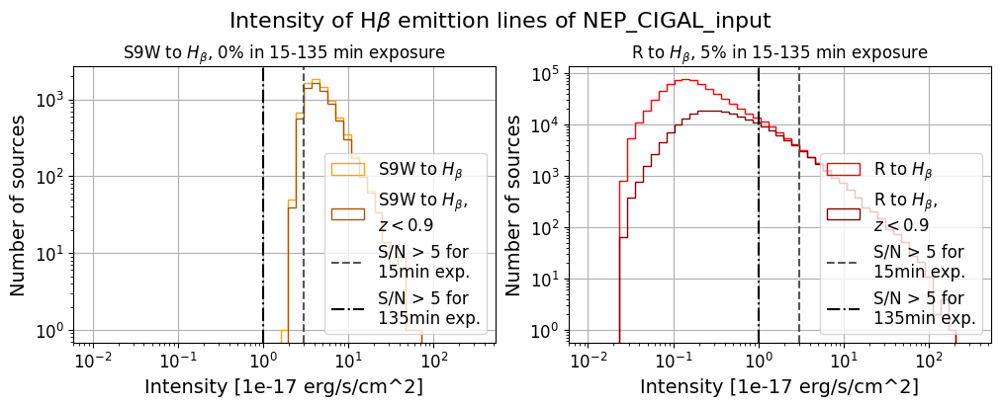

In [20]:
fig, axs = plt.subplots(1,2, figsize=(10,4), constrained_layout=True)

bins = np.logspace(-2, 2.5, 50)

ax = axs[0]
ax.hist(S9W_E_I, bins=bins, histtype='step', color='orange', label='S9W to $H_{\\beta}$')
ax.hist(NEP_Will_lowz['S9W_E_I'], bins=bins, histtype='step', color='#AA5500', label='S9W to $H_{\\beta}$, \n$z<0.9$')
ax.set_title('S9W to $H_{\\beta}$, '+str(fraction(S9W_E_I))+'% in 15-135 min exposure')

ax = axs[1]
ax.hist(R_E_I, bins=bins, histtype='step', color='r', label='R to $H_{\\beta}$')
ax.hist(NEP_Will_lowz['R_E_I'], bins=bins, histtype='step', color='#880000', label='R to $H_{\\beta}$, \n$z<0.9$')
ax.set_title('R to $H_{\\beta}$, '+str(fraction(R_E_I))+'% in 15-135 min exposure')

for _, ax in enumerate(axs.flatten()):
    ax.axvline(3, color='#555555', linestyle='--', label='S/N > 5 for \n15min exp.')
    ax.axvline(1, color='k', linestyle='-.', label='S/N > 5 for \n135min exp.')
    ax.legend(loc='lower right', fontsize=12)
    ax.set_ylabel('Number of sources', fontsize=14)
    ax.grid()
    ax.set_yscale('log')
    ax.set_xscale('log')
    # ax.set_xlim(0.2, 2000)
    ax.set_xlabel('Intensity [1e-17 erg/s/cm^2]', fontsize=14)
    ax.tick_params(axis='both', labelsize=12)
    
plt.suptitle('Intensity of H$\\beta$ emittion lines'+
            ' of NEP_CIGAL_input', fontsize=16)

plt.show()

In [34]:
NEP_Will.keys().tolist()

['id',
 'ra',
 'dec',
 'FLAMINGOSJ',
 'FLAMINGOSJ_err',
 'FLAMINGOSH',
 'FLAMINGOSH_err',
 'IRAC1',
 'IRAC1_err',
 'IRAC2',
 'IRAC2_err',
 'MCam_u',
 'MCam_u_err',
 'WIRCAM_J',
 'WIRCAM_J_err',
 'WIRCAM_Ks',
 'WIRCAM_Ks_err',
 'HSC_g',
 'HSC_g_err',
 'HSC_r',
 'HSC_r_err',
 'HSC_i',
 'HSC_i_err',
 'HSC_z',
 'HSC_z_err',
 'HSC_y',
 'HSC_y_err',
 'akari_irc_s7',
 'akari_irc_s7_err',
 'akari_irc_s9w',
 'akari_irc_s9w_err',
 'redshift']

### HSC sources

#### data

In [125]:
nepsource = pd.read_csv('NEP_mergedcat.csv')
hscdata1 = pd.read_csv('HSCcatalog1130.csv')
# hscdata2 = pd.read_csv('HSC_catalog_20210317.csv')
# they are almost the same, but the second one has more columns
mask = (hscdata1['photo-z']>0)&(hscdata1['sfr_med']>0)
redshift = hscdata1['photo-z'].loc[mask]
sfr = hscdata1['sfr_med'].loc[mask]

In [9]:
len(hscdata1), len(hscdata2)

(747673, 747673)

#### intensity

In [6]:
hscdata1 = pd.read_csv('HSCcatalog1130.csv', 
    usecols=['HSC-ID', 'mag_abs_r', 'mag_abs_i', 'spec-z', 'photz', 'sfr_med', 'chi_gal', 'chi_star', 
             'forced_RA', 'forced_Dec'])
mask = (hscdata1['photz']>0)&(hscdata1['sfr_med']>0)
r_abs = hscdata1['mag_abs_r']
r_ab = M_Abs2m_ab(r_abs, z=hscdata1['photz'])
hscdata1['r_hsc'] = r_ab
i_abs = hscdata1['mag_abs_i']
i_ab = M_Abs2m_ab(i_abs, z=hscdata1['photz'])
hscdata1['ICm'] = i_ab
data = hscdata1.loc[mask&(hscdata1['r_hsc']>14)]
sfr = data['sfr_med']
redshift = data['photz']

data['H_a'] = SFR2Halpha_obs(sfr, redshift)

/home/amos/miniconda3/envs/Eva00/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/home/amos/miniconda3/envs/Eva00/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/tmp/ipykernel_149564/4184779475.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['H_a'] = SFR2Halpha_obs(sfr, redshift)


In [7]:
data['H_a'] = data['H_a'].apply(lambda x: x.value)
data['H_a'] = data['H_a']*1e17

/tmp/ipykernel_149564/2224170993.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['H_a'] = data['H_a'].apply(lambda x: x.value)
/tmp/ipykernel_149564/2224170993.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['H_a'] = data['H_a']*1e17


In [50]:
len(data.loc[
    (hscdata1['photz']<0.9)
    &(hscdata1['spec-z']<-90)
    &(hscdata1['r_hsc']>14)
    &(data['chi_gal']<data['chi_star'])
    ])

29385

In [9]:
data.loc[
    # (hscdata1['photz']<0.9)
    (hscdata1['spec-z']<-90)
    &(hscdata1['r_hsc']>14)
    &(data['chi_gal']<data['chi_star']), 
    ['HSC-ID', 'forced_RA', 'forced_Dec', 'r_hsc', 'ICm', 'H_a']
    ].to_csv('HSC_simon.csv')

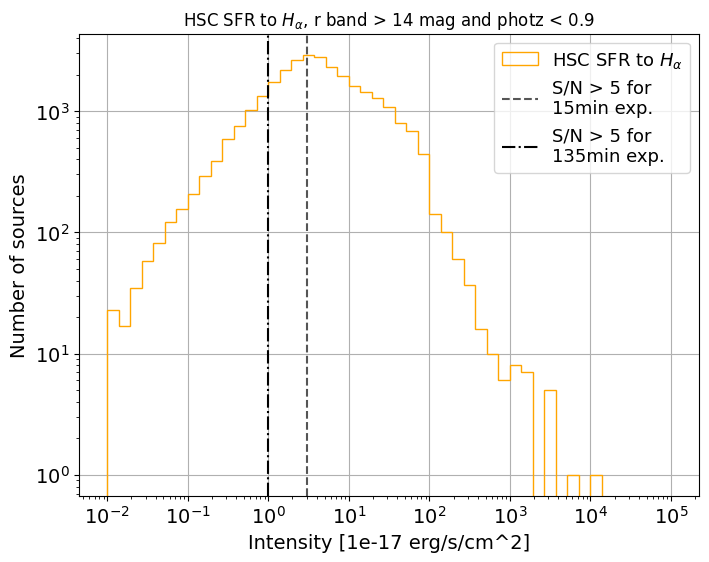

In [19]:
testdata = pd.read_csv('HSC_lowz2.csv')
fig, ax = plt.subplots(1, 1, figsize=(8,6))

bins = np.logspace(-2, 5, 50)

ax.hist(testdata['H_a']*1e17, bins=bins, histtype='step', color='orange', label='HSC SFR to $H_{\\alpha}$')
# ax.hist(H_a_0p9, bins=bins, histtype='step', color='r', label='HSC SFR to $H_{\\alpha}$, \nphotz < 0.9')
ax.set_title('HSC SFR to $H_{\\alpha}$, r band > 14 mag and photz < 0.9')

ax.axvline(3, color='#555555', linestyle='--', label='S/N > 5 for \n15min exp.')
ax.axvline(1, color='k', linestyle='-.', label='S/N > 5 for \n135min exp.')
ax.legend(loc='upper right', fontsize=13)
ax.set_ylabel('Number of sources', fontsize=14)
ax.grid()
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('Intensity [1e-17 erg/s/cm^2]', fontsize=14)
ax.tick_params(axis='both', which='major', labelsize=14)

plt.show()

In [15]:
hscdata1 = pd.read_csv('HSC_SFR_Ha.csv')
r_abs = hscdata1['mag_abs_r']
r_ab = M_Abs2m_ab(r_abs, z=hscdata1['photo-z'])

In [21]:
hscdata1['r_AB'] = r_ab
hscdata1[(hscdata1['photo-z']<0.9)&(hscdata1['r_AB']>14)].to_csv('HSC_SFR_Ha_0p9.csv', index=False)

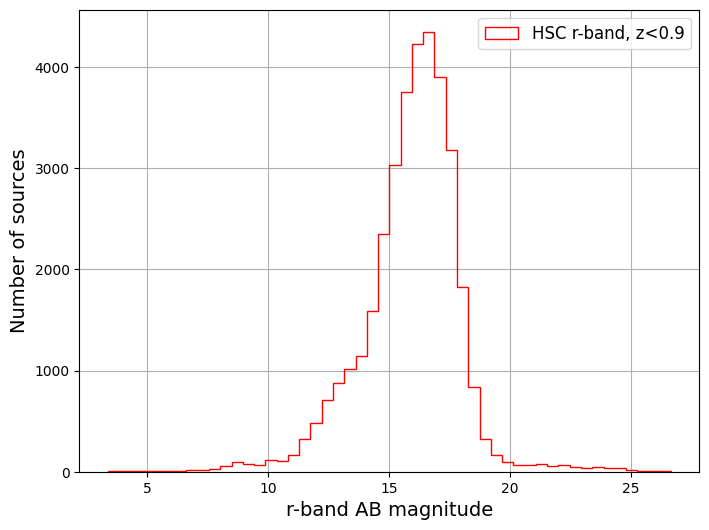

In [19]:
fig, ax = plt.subplots(1, 1, figsize=(8,6))

# ax.hist(hscdata1['r_AB'], bins=50, histtype='step', color='k', label='HSC r-band')
ax.hist(hscdata1['r_AB'].loc[hscdata1['photo-z']<0.9], bins=50, histtype='step', color='r', label='HSC r-band, z<0.9')

ax.set_xlabel('r-band AB magnitude', fontsize=14)
ax.set_ylabel('Number of sources', fontsize=14)
ax.legend(fontsize=12)
ax.grid()

plt.show()

#### SFR

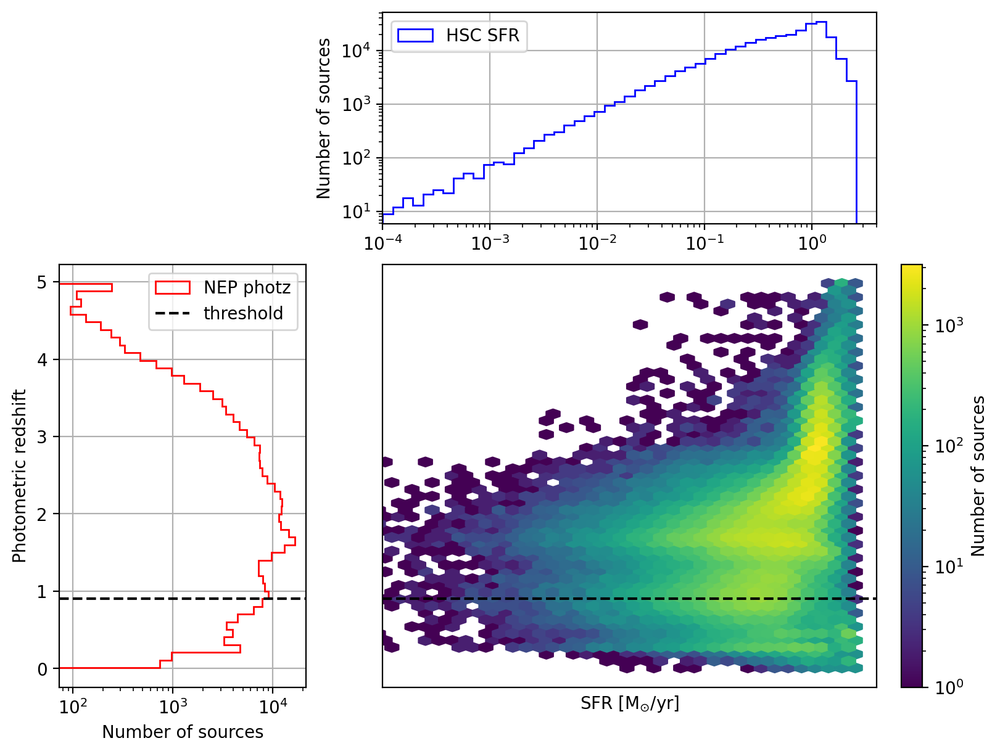

In [87]:
fig = plt.figure(figsize=(8,6), constrained_layout=True, dpi=200)

ax1 = plt.subplot2grid((3, 3), (0, 1), colspan=2)
ax2 = plt.subplot2grid((3, 3), (1, 0), rowspan=2)
ax3 = plt.subplot2grid((3, 3), (1, 1), colspan=2, rowspan=2)

xrange = [1e-4, 4e0]

ax = ax1
bins = np.logspace(np.log10(xrange[0]), np.log10(xrange[1]), 50)
ax.hist(sfr, bins=bins, histtype='step', color='b', label='HSC SFR')

# ax.set_xlabel('SFR [M$_{\odot}$/yr]')
ax.set_ylabel('Number of sources')
ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlim(xrange[0], xrange[1])
ax.legend()
ax.grid()

ax = ax2
ax.hist(redshift, bins=50, histtype='step', color='r', label='NEP photz', orientation='horizontal')
ax.axhline(0.9, color='k', linestyle='--', label='threshold')

ax.set_ylabel('Photometric redshift')
ax.set_xlabel('Number of sources')
ax.set_xscale('log')
ax.legend()
ax.grid()

ax = ax3
# ax.scatter(sfr, redshift, s=5, color='#AA00AA', alpha=0.1, label='HSC SFR vs NEP photz')
hb = ax.hexbin(np.log10(sfr), redshift, gridsize=50, cmap='viridis', mincnt=1, bins='log')
colorbar = fig.colorbar(hb, ax=ax)
colorbar.set_label('Number of sources')
ax.axhline(0.9, color='k', linestyle='--', label='threshold')

ax.set_xlabel(r'SFR [M$_{\odot}$/yr]')
ax.set_xticks([])
ax.set_yticks([])
ax.set_xlim(np.log10(xrange[0]), np.log10(xrange[1]))
ax.grid()


#### r-H_beta Ece

In [11]:
data = pd.read_csv('AKARI-FIS_BSC_V2_nospecz_nep_4sources_gaiacoord.csv')
sigma = 2
R2Hbeta = [0.03-0.31*sigma, 0.84]
R_I_beta = EmittionLineIntensity(data['phot_rp_mean_mag'], R2Hbeta)

In [13]:
AB_2_Jy(data['phot_rp_mean_mag'])*1e9
1194846

0    1.194846e+06
1    3.623111e+07
2    1.131876e+06
3    4.204140e+05
Name: phot_rp_mean_mag, dtype: float64

In [12]:
R_I_beta

0      98.842126
1    1736.315107
2      94.447614
3      41.104451
Name: phot_rp_mean_mag, dtype: float64

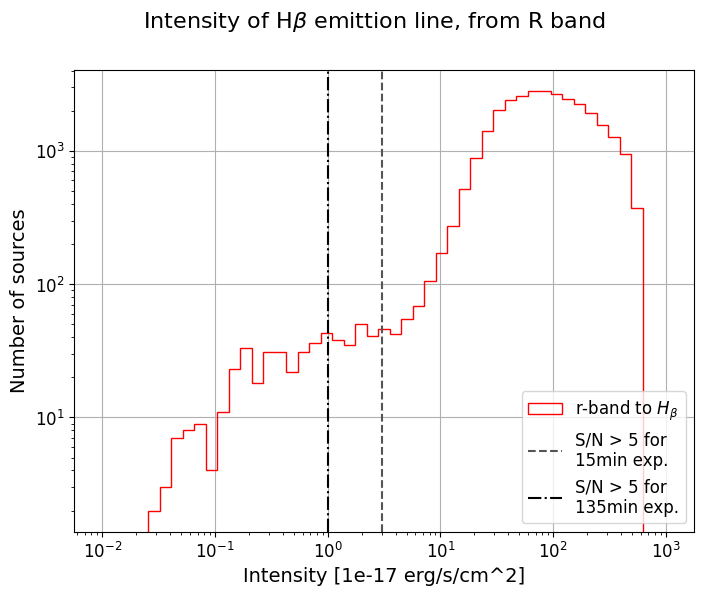

In [12]:
fig, ax = plt.subplots(1, 1, figsize=(8,6))

bins = np.logspace(-2, 3, 50)

ax.hist(R_I_beta, bins=bins, histtype='step', color='r', label='r-band to $H_{\\beta}$')
ax.axvline(3, color='#555555', linestyle='--', label='S/N > 5 for \n15min exp.')
ax.axvline(1, color='k', linestyle='-.', label='S/N > 5 for \n135min exp.')

ax.set_ylabel('Number of sources', fontsize=14)
ax.grid()
ax.set_yscale('log')
ax.set_xscale('log')
# ax.set_xlim(0.2, 2000)
ax.set_xlabel('Intensity [1e-17 erg/s/cm^2]', fontsize=14)
ax.tick_params(axis='both', labelsize=12)
ax.legend(loc='lower right', fontsize=12)

plt.suptitle('Intensity of H$\\beta$ emittion line, from R band', fontsize=16)

plt.show()

#### emission

In [111]:
SFR2Halpha(1, 0.8)

<Quantity 8.95845646e-17 erg / (s cm2)>

In [3]:
data = pd.read_csv('HSC_SFR_Ha_0p9.csv')
sfr = data['sfr_med']
redshift = data['photz']

H_alpha = SFR2Halpha(sfr, redshift)
# H_alpha_0p9 = SFR2Halpha(sfr[redshift<0.9], redshift[redshift<0.9])

In [4]:
H_a = H_alpha * 1e17 # [1e-17 erg/s/cm^2]
# remove H_a's unit
H_a = H_a.apply(lambda x: x.value)
# H_a_0p9 = H_alpha_0p9 * 1e17 # [1e-17 erg/s/cm^2]
# H_a_0p9 = H_a_0p9.apply(lambda x: x.value)

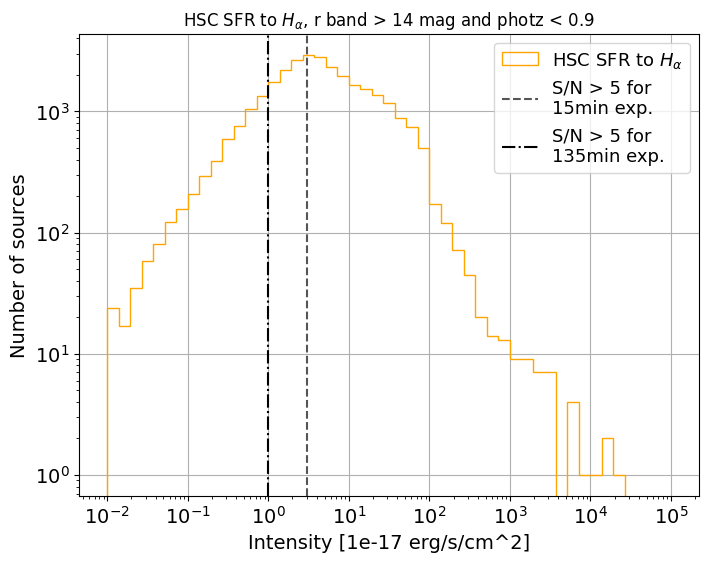

In [5]:
fig, ax = plt.subplots(1, 1, figsize=(8,6))

bins = np.logspace(-2, 5, 50)

ax.hist(H_a, bins=bins, histtype='step', color='orange', label='HSC SFR to $H_{\\alpha}$')
# ax.hist(H_a_0p9, bins=bins, histtype='step', color='r', label='HSC SFR to $H_{\\alpha}$, \nphotz < 0.9')
ax.set_title('HSC SFR to $H_{\\alpha}$, r band > 14 mag and photz < 0.9')

ax.axvline(3, color='#555555', linestyle='--', label='S/N > 5 for \n15min exp.')
ax.axvline(1, color='k', linestyle='-.', label='S/N > 5 for \n135min exp.')
ax.legend(loc='upper right', fontsize=13)
ax.set_ylabel('Number of sources', fontsize=14)
ax.grid()
ax.set_yscale('log')
ax.set_xscale('log')
ax.set_xlabel('Intensity [1e-17 erg/s/cm^2]', fontsize=14)
ax.tick_params(axis='both', which='major', labelsize=14)

plt.show()

In [126]:
output = hscdata1.loc[mask]
output['H_a'] = H_a
output.to_csv('HSC_SFR_Ha.csv', index=False)

/tmp/ipykernel_931/1482329088.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  output['H_a'] = H_a


## Merge Cat

### cat

In [13]:
hsc_highz = pd.read_csv('HSC_highz.csv', usecols=['HSC-ID'])
hsc_highz['priority'] = 4

hscdata1 = pd.read_csv('HSC_lowz.csv', usecols=['HSC-ID'])
hscdata1['priority'] = 3

LSBGs = pd.read_csv('LSBGs.csv', usecols=['HSC-ID'])
LSBGs['priority'] = 2

nepsource_hz = pd.read_csv('SJ_highz.csv', usecols=['HSC-ID'])
nepsource_hz['priority'] = 1

nepsource_lz = pd.read_csv('SJ_lowz.csv', usecols=['HSC-ID'])
nepsource_lz['priority'] = 0


# NEP_Will_highz = pd.read_csv('NEP_Will_highz.csv')
# NEP_Will_highz['priority'] = 1

# NEP_Will_lowz = pd.read_csv('NEP_Will_lowz.csv')
# NEP_Will_lowz['priority'] = 0

# merger = Table.read('NEP-mergers.fits', format='fits').to_pandas()
# merger['HSC-ID'] = merger['HSC_ID']
# merger['priority'] = 0

# NEP_Will = Table.read('NEP_CIGALE_input.fits', format='fits').to_pandas()

# LSBGs = Table.read('Subaru_PSF_proposal_LSBs_Junais.fits', format='fits').to_pandas()
# LSBGs['HSC-ID'] = LSBGs['id']
# LSBGs['priority'] = 0
# LSBGs = LSBGs[['HSC-ID', 'ra', 'dec', 'subaru.hsc.g', 'subaru.hsc.r', 'priority']]

# cat = pd.concat([hsc_highz, hscdata1], axis=0)
# print(len(cat))
# cat = pd.concat([cat, LSBGs], axis=0)
# print(len(cat))
# cat = pd.concat([cat, nepsource_hz], axis=0)
# print(len(cat))
# cat = pd.concat([cat, nepsource_lz], axis=0)
# print(len(cat))
cat = pd.concat([nepsource_hz, nepsource_lz], axis=0)
print(len(cat))
cat = pd.concat([cat, LSBGs], axis=0)
print(len(cat))
cat = pd.concat([cat, hscdata1], axis=0)
print(len(cat))
cat = pd.concat([cat, hsc_highz], axis=0)
print(len(cat))

# cat = cat[~cat.duplicated(subset='HSC-ID')]
# print(len(cat))
# # # print(len(nepsource) + len(hscdata1) + len(merger) + len(LSBGs))
# len(cat), len(nepsource_lz), len(hscdata1), len(merger), len(LSBGs), len(hsc_highz)

12374
14005
43390
275411


In [16]:
cat = cat[~cat.duplicated(subset='HSC-ID')]
print(len(cat), len(cat[cat['priority']==0]))

272104 7612


In [17]:
cat.to_csv('Mergedcat4PFS-id.csv', index=False)

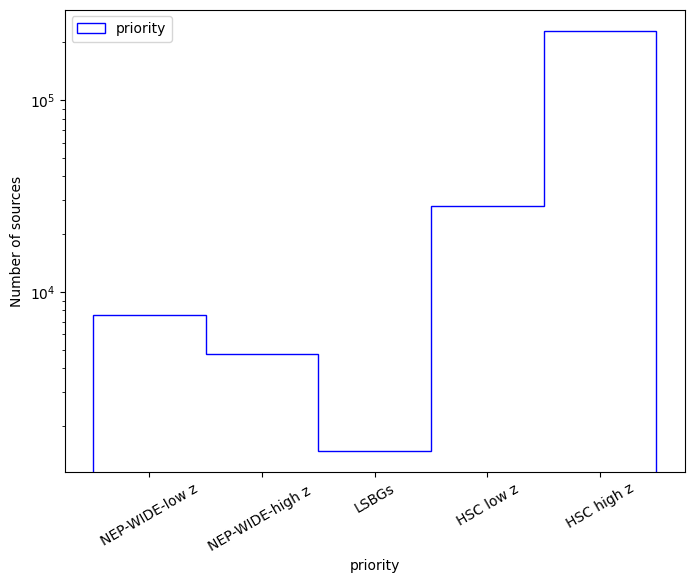

In [9]:
# plot histogram of cat
fig, ax = plt.subplots(1, 1, figsize=(8,6))

bins = np.arange(6)-0.5

ax.hist(cat['priority'], bins=bins, histtype='step', color='b', label='priority')

ax.set_xlabel('priority')
ax.set_ylabel('Number of sources')
ax.set_yscale('log')
# set x ticks with a list of strings
ticks =['NEP-WIDE-low z', 'NEP-WIDE-high z ', 'LSBGs', 'HSC low z', 'HSC high z']

plt.xticks(range(5), ticks, rotation=30)

ax.legend()

In [2]:
cat = pd.read_csv('Mergedcat4PFS.csv')
will = Table.read('NEP_CIGALE_input.fits', format='fits').to_pandas()
will['HSC-ID'] = will['id']
cat = pd.concat([cat, will], axis=0)
cat = cat[~cat.duplicated(subset='HSC-ID')]
print(len(cat))

/tmp/ipykernel_951/3410684068.py:1: DtypeWarning: Columns (0,47,67,69,71,73,75,77,81,84,85,86,87,96,117,119,125,130,147,179) have mixed types. Specify dtype option on import or set low_memory=False.
  cat = pd.read_csv('Mergedcat4PFS.csv')


710670


In [7]:
# cat = pd.read_csv('Mergedcat4PFS.csv')
cat = Table.read('NEP_CIGALE_input.fits', format='fits').to_pandas()
cat['HSC-ID'] = cat['id']
simon = pd.read_csv('HSCcatalog1130.csv')
cat = pd.concat([cat, simon], axis=0)
print(len(cat))
cat = cat[~cat.duplicated(subset='HSC-ID')]
print(len(cat))

merger = Table.read('NEP-mergers.fits', format='fits').to_pandas()
merger['HSC-ID'] = merger['HSC_ID']
# merger['priority'] = 0

cat = pd.concat([cat, merger], axis=0)
print(len(cat))
cat = cat[~cat.duplicated(subset='HSC-ID')]
print(len(cat))

1450301
747673
749805
747673


In [2]:
1450301-747673

702628

In [8]:
749805-747673

2132

In [2]:
nepsource_lz = pd.read_csv('SJ_lowz.csv')
nepsource_hz = pd.read_csv('SJ_highz.csv')
hscdata1 = pd.read_csv('HSC_lowz.csv')
hsc_highz = pd.read_csv('HSC_highz.csv')
LSBGs = pd.read_csv('LSBGs.csv')
NEP_Will_highz = pd.read_csv('NEP_Will_highz.csv')
NEP_Will_lowz = pd.read_csv('NEP_Will_lowz.csv')
cat = pd.concat([nepsource_lz, nepsource_hz], axis=0)
print(len(cat))
cat = cat[~cat.duplicated(subset='HSC-ID')]
print('re', len(cat))

# cat = pd.concat([cat, NEP_Will_highz], axis=0)
# print(len(cat))
# cat = cat[~cat.duplicated(subset='HSC-ID')]
# print('re', len(cat))

# cat = pd.concat([cat, NEP_Will_lowz], axis=0)
# print(len(cat))
# cat = cat[~cat.duplicated(subset='HSC-ID')]
# print('re', len(cat))

cat = pd.concat([cat, hscdata1], axis=0)
print(len(cat))
cat = cat[~cat.duplicated(subset='HSC-ID')]
print('re', len(cat))

cat = pd.concat([cat, hsc_highz], axis=0)
print(len(cat))
cat = cat[~cat.duplicated(subset='HSC-ID')]
print('re', len(cat))

cat = pd.concat([cat, LSBGs], axis=0)
print(len(cat))
cat = cat[~cat.duplicated(subset='HSC-ID')]
print('re', len(cat))


12374
re 12374
41759
re 40376
272397
re 270624
272255
re 146183


In [4]:
nepsource_lz = pd.read_csv('SJ_lowz.csv')

In [5]:
nepsource_lz['HSC-ID']

0       79217643822780069
1       79217643822780448
2       79217643822781099
3       79217643822781289
4       79217643822781311
              ...        
7607    80097781406009997
7608    80097781406010034
7609    80097781406011860
7610    80097781406014267
7611    80097781406015424
Name: HSC-ID, Length: 7612, dtype: int64

In [3]:
cat

,# Trt-Ptch,HSC-ID,forced_RA,forced-Dec,GCm,GCme,RCm,RCme,ICm,ICme,...,S11_err,L15,L15_err,L18W,L18W_err,L24,L24_err,flag,H_b_L18,H_b_S9
0,18012_0_7,7.921764e+16,270.727692,65.316605,23.481,0.014,21.951,0.005,21.276,0.010,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,18012_0_7,7.921764e+16,270.747009,65.351997,21.705,0.004,20.215,0.001,19.425,0.002,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,18012_0_7,7.921764e+16,270.745941,65.342209,21.695,0.004,20.555,0.002,20.245,0.006,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,18012_0_7,7.921764e+16,270.748535,65.301315,22.028,0.008,20.708,0.002,99.000,99.000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,18012_0_7,7.921764e+16,270.742523,65.306000,23.291,0.018,21.808,0.004,99.000,99.000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
232016,NaN,8.009834e+16,271.073242,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
232018,NaN,8.009834e+16,270.951935,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
232019,NaN,8.009834e+16,270.996307,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
232020,NaN,8.009834e+16,270.948212,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [28]:
LSBGs.keys().to_list()

['id',
 'ra',
 'dec',
 'redshift',
 'subaru.hsc.g',
 'subaru.hsc.g_err',
 'subaru.hsc.r',
 'subaru.hsc.r_err',
 'subaru.hsc.i',
 'subaru.hsc.i_err',
 'subaru.hsc.z',
 'subaru.hsc.z_err',
 'subaru.hsc.y',
 'subaru.hsc.y_err',
 'N2',
 'N2_err',
 'N3',
 'N3_err',
 'N4',
 'N4_err',
 'S7',
 'S7_err',
 'S9W',
 'S9W_err',
 'S11',
 'S11_err',
 'L15',
 'L15_err',
 'L18W',
 'L18W_err',
 'L24',
 'L24_err',
 'flag',
 'HSC-ID',
 'priority']

In [ ]:
cat.to_csv('HSC.csv', index=False)

In [3]:
# cat = hsc_highz
# cat = merger
# cat = LSBGs
# cat = nepsource
# cat = hscdata1
cat = pd.read_csv('NEP_Will_highz.csv')
# cat = pd.read_csv('NEP_Will_lowz.csv')
print(len(cat))
cat = cat[~cat.duplicated(subset='HSC-ID')]
len(cat)

475563


475563

In [5]:
merger.keys().tolist()

['HSC_ID',
 'forced_RA',
 'forced_Dec',
 'spec_z',
 'photo_z',
 'best_z',
 'vis_merger']

In [13]:
def crossmatch(data1, data2, radius=1., merge=True):
    
    ''' Crossmatch two datasets using astropy.coordinates.match_coordinates_sky
    and return a merged dataset with matched rows from both datasets.
    
    Parameters:
    data1 (DataFrame): First dataset to crossmatch, ['ra', 'dec']
    data2 (DataFrame): Second dataset to crossmatch, ['ra', 'dec']
    radius (float): Maximum separation between matches in arcseconds
    
    Returns:
    merged_data (DataFrame): Merged dataset containing matched rows from data1 and data2
    
    ''' 
    
    from astropy.coordinates import match_coordinates_sky
    from astropy.coordinates import SkyCoord
        
    # Create SkyCoord objects for both datasets
    coords1 = SkyCoord(ra=data1['forced_RA'], dec=data1['forced_Dec'], unit="deg")
    coords2 = SkyCoord(ra=data2['forced_RA'], dec=data2['forced-Dec'], unit="deg")

    # Find the nearest neighbors in coords2 for each point in coords1
    idx, d2d, d3d = match_coordinates_sky(coords1, coords2, nthneighbor=1)

    # Create a mask for matches within the specified radius
    mask = d2d.arcsec <= radius

    # Add matching indices and distances to data1
    data1['idx'] = idx
    data1['d2d'] = d2d.arcsec
    
    if merge:

        # Filter data1 and data2 to only include matches, iloc is used to keep the same index
        matched_data1 = data1[mask].reset_index(drop=True)
        matched_data2 = data2.iloc[idx[mask]].reset_index(drop=True)

        # Merge matched rows from data1 and data2
        merged_data = pd.concat([matched_data1, matched_data2], axis=1)

        return merged_data
    
    else:
        return data1[mask]

In [15]:
matched = crossmatch(
    hscdata1, nepsource,
    0.1, merge=False
)

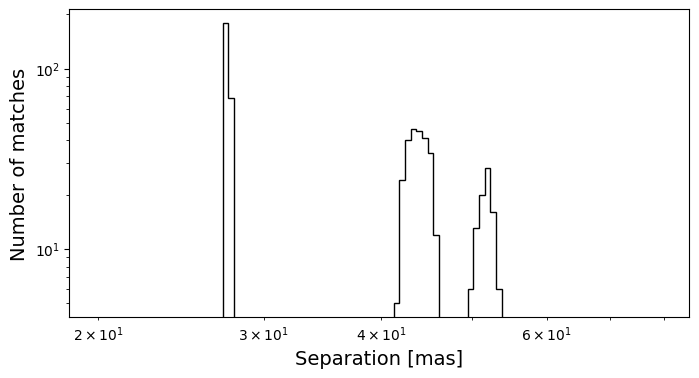

In [16]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4))

bins = np.logspace(-1.7+3, -1.1+3, 100)
ax.hist(matched['d2d']*1000, bins=bins, histtype='step', color='k')

ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('Separation [mas]', fontsize=14)
ax.set_ylabel('Number of matches', fontsize=14)

plt.show()

#### All L18W, S9W sources

In [38]:
L18WE_I_alpha = EmittionLineIntensity(NEPW_L18W['Mag'], L18W2Halpha)
L18WE_I_beta = EmittionLineIntensity(NEPW_L18W['Mag'], L18W2Hbeta)
S9WE_I_alpha = EmittionLineIntensity(NEPW_S9W['Mag'], S9W2Halpha)
S9WE_I_beta = EmittionLineIntensity(NEPW_S9W['Mag'], S9W2Hbeta)

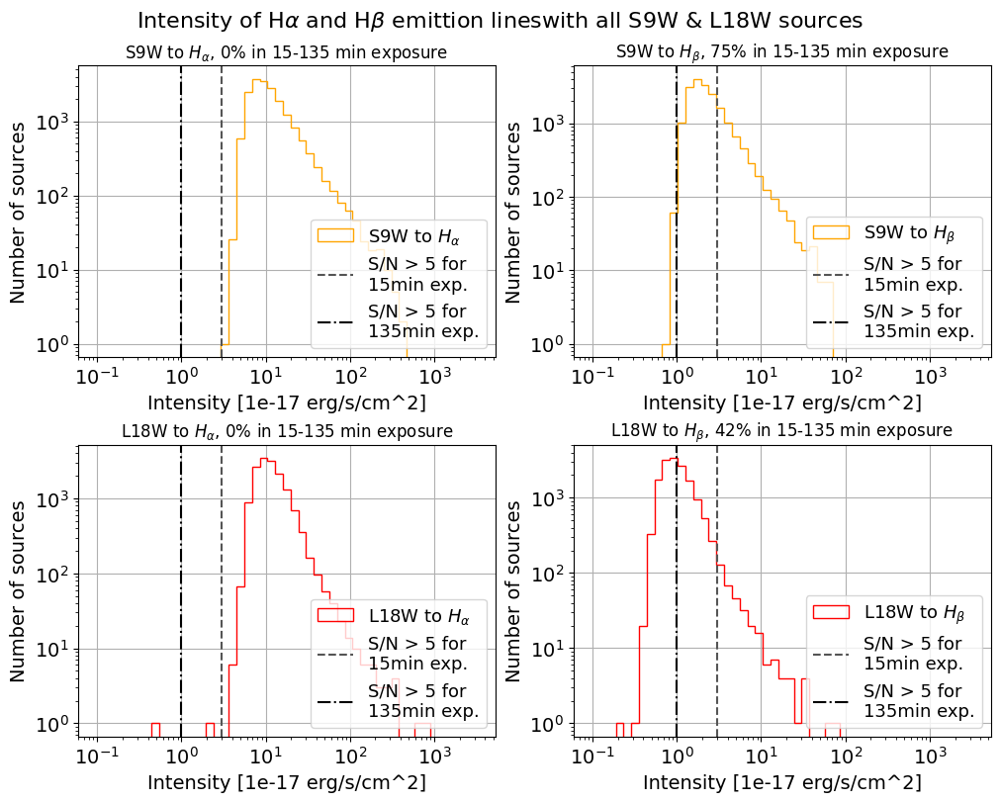

In [42]:
fig, axs = plt.subplots(2,2, figsize=(10,8), constrained_layout=True)

bins = np.logspace(-1, 3.5, 50)

ax = axs[0, 0]
ax.hist(S9WE_I_alpha, bins=bins, histtype='step', color='orange', label='S9W to $H_{\\alpha}$')
ax.set_title('S9W to $H_{\\alpha}$, '+str(fraction(S9WE_I_alpha))+'% in 15-135 min exposure')

ax = axs[0, 1]
ax.hist(S9WE_I_beta, bins=bins, histtype='step', color='orange', label='S9W to $H_{\\beta}$')
ax.set_title('S9W to $H_{\\beta}$, '+str(fraction(S9WE_I_beta))+'% in 15-135 min exposure')

ax = axs[1, 0]
ax.hist(L18WE_I_alpha, bins=bins, histtype='step', color='r', label='L18W to $H_{\\alpha}$')
ax.set_title('L18W to $H_{\\alpha}$, '+str(fraction(L18WE_I_alpha))+'% in 15-135 min exposure')

ax = axs[1, 1]
ax.hist(L18WE_I_beta, bins=bins, histtype='step', color='r', label='L18W to $H_{\\beta}$')
ax.set_title('L18W to $H_{\\beta}$, '+str(fraction(L18WE_I_beta))+'% in 15-135 min exposure')

for _, ax in enumerate(axs.flatten()):
    ax.axvline(3, color='#555555', linestyle='--', label='S/N > 5 for \n15min exp.')
    ax.axvline(1, color='k', linestyle='-.', label='S/N > 5 for \n135min exp.')
    ax.legend(loc='lower right', fontsize=13)
    ax.set_ylabel('Number of sources', fontsize=14)
    ax.grid()
    ax.set_yscale('log')
    ax.set_xscale('log')
    ax.set_xlabel('Intensity [1e-17 erg/s/cm^2]', fontsize=14)
    ax.tick_params(axis='both', which='major', labelsize=14)

plt.suptitle('Intensity of H$\\alpha$ and H$\\beta$ emittion lines'+
            'with all S9W & L18W sources', fontsize=16)

plt.show()

### Mag hist

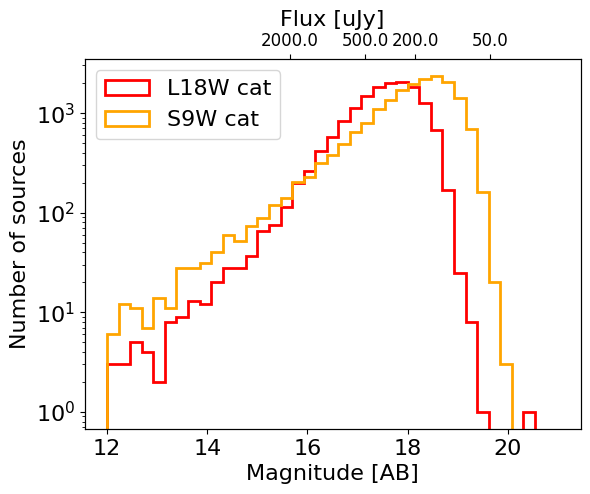

In [98]:
fig, ax = plt.subplots()

bins = np.linspace(12, 21, 40)

# ax.hist(S9mag, bins=bins, histtype='step', color='orange', linewidth=2, label='S9W')
# ax.hist(S9mag_nospec, bins=bins, histtype='step', color='#AA8800', linewidth=2, label='S9W no spectrum')
# ax.hist(L18mag, bins=bins, histtype='step', color='r', linewidth=2, label='L18W')
# ax.hist(L18mag_nospec, bins=bins, histtype='step', color='#AA0000', linewidth=2, label='L18W no spectrum')
ax.hist(NEPW_L18W['Mag'].astype(float), bins=bins, histtype='step', color='r', linewidth=2, label='L18W cat')
ax.hist(NEPW_S9W['Mag'].astype(float), bins=bins, histtype='step', color='orange', linewidth=2, label='S9W cat')
# ax.hist(Both['S9m'].astype(float), bins=bins, histtype='step', color='b', linewidth=2, label='Both')

ax.set_xlabel('Magnitude [AB]', fontsize=16)
ax.set_ylabel('Number of sources', fontsize=16)
ax.set_yscale('log')
ax.legend(fontsize=16)
ax.tick_params(axis='both', labelsize=16)

new_tick_locations = np.array([Jy_2_AB(5e-5), Jy_2_AB(2e-4),Jy_2_AB(5e-4), Jy_2_AB(2e-3)])

ax2 = ax.twiny()
ax2.set_xlim(ax.get_xlim())
ax2.set_xticks(new_tick_locations)
l_tiny = AB_2_Jy(new_tick_locations)*1e6
# round to 2 decimal places, scientific notation
ax2.set_xticklabels(l_tiny.round(2))

ax2.set_xlabel('Flux [uJy]', fontsize=16)
ax2.tick_params(axis='both', labelsize=12)

plt.show()

In [80]:
Jy_2_AB(5e-5)

19.65257498915995

### modification

In [19]:
groupdata4 = pd.read_csv('NEP_PFS_Targets_10exp_re-pri_group1.csv')

In [17]:
groupdata4[groupdata4['exptime']<3601].to_csv('NEP_PFS_Targets_4exp_re-pri_group1.csv', index=False)
groupdata4[groupdata4['exptime']<5401].to_csv('NEP_PFS_Targets_6exp_re-pri_group1.csv', index=False)

(array([ 2019.,  1041.,   362.,  6075., 20189.]),
 array([-0.5,  0.5,  1.5,  2.5,  3.5,  4.5]),
 [<matplotlib.patches.Polygon at 0x7f55c6c723f0>])

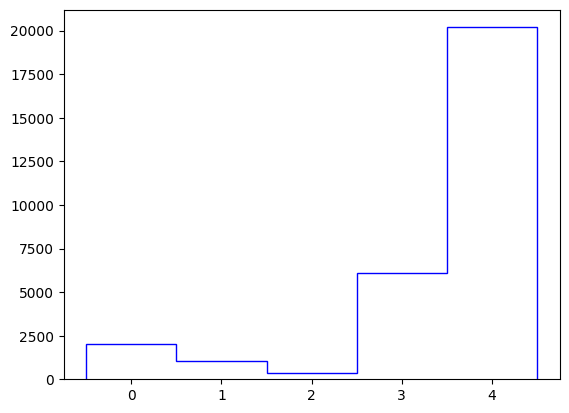

In [21]:
plt.hist(groupdata4['priority'], bins=[-0.5, 0.5, 1.5, 2.5, 3.5, 4.5], histtype='step', color='b')

In [22]:
for i in range(len(groupdata4)):
    if groupdata4['exptime'].iloc[i] < 6301:
        groupdata4['priority'].iloc[i] = groupdata4['priority'].iloc[i]*2
    else:
        groupdata4['priority'].iloc[i] = groupdata4['priority'].iloc[i]*2+1

/tmp/ipykernel_64251/2821979391.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  groupdata4['priority'].iloc[i] = groupdata4['priority'].iloc[i]*2
/tmp/ipykernel_64251/2821979391.py:3: SettingWithCopyWarning: 
A value is trying to be set 

(array([ 2019.,     0.,  1041.,     0.,   362.,     0.,  5882.,   193.,
        14222.]),
 array([-0.5,  0.5,  1.5,  2.5,  3.5,  4.5,  5.5,  6.5,  7.5,  8.5]),
 [<matplotlib.patches.Polygon at 0x7f55c6aa6f60>])

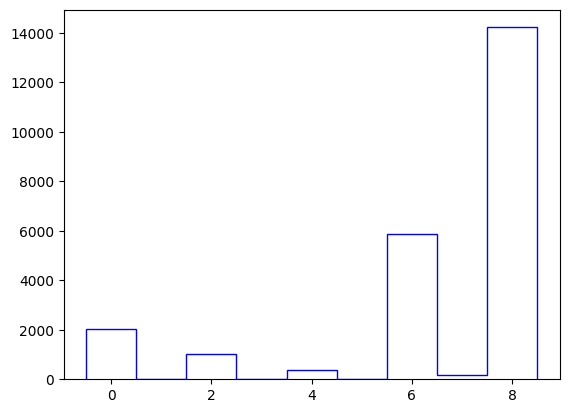

In [25]:
bins = np.linspace(-0.5, 8.5, 10)
plt.hist(groupdata4['priority'], bins=bins, histtype='step', color='b')

In [26]:
groupdata4.to_csv('NEP_PFS_Targets_10exp_re-pri2_group1.csv', index=False)

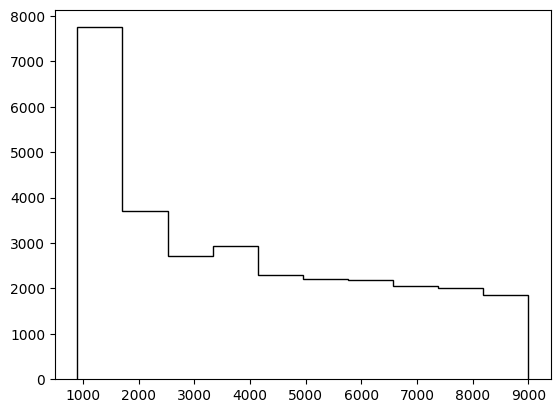

In [4]:
fig, ax = plt.subplots()

ax.hist(groupdata4['exptime'], bins=10, histtype='step', color='k')

plt.show()  